# Comprehensive Model Evaluation and Comparison  
## Complete Analysis of All Colorization Models

This notebook provides a **comprehensive evaluation and summary** of all trained colorization models, using both **quantitative metrics** and **qualitative visual inspection**.

The following models are included:

- **Models A–F**: Core architectural and loss-function variants.
- **Model C variants**: Targeted ablations around the main model (C) with different $L_1$ and perceptual loss weights.

### Scope of the Evaluation

This notebook focuses on:

1. **Global metrics summary** across all models:
   - PSNR, SSIM, CIEDE2000, LPIPS, and best validation loss.
2. **Comparative visualizations**:
   - Bar plots and ranking of metrics to summarize relative performance.
3. **Training history analysis**:
   - Comparison of training and validation loss curves across models.
4. **Side-by-side inference comparison**:
   - Visual evaluation of model outputs on the **same subset** of test images.
5. **Aggregated inference metrics**:
   - Averaged metric values over shared test samples for fair comparison.
6. **Best model identification and ranking**:
   - Determining the top-performing models from multiple evaluation criteria.
7. **Final summary report**:
   - Concise description of key findings and evaluation conclusions.

The primary aim is to produce a **clear, reproducible, and interpretable evaluation** that can be used in a project report or thesis to justify which model configuration should be considered the **best overall**.


## 1. Setup and Imports

This section prepares the **evaluation environment** by importing all required libraries.

The imports cover:

- **Core utilities**  
  `glob`, `random`, `warnings`, `Path` – for file handling, randomness control, and warning management.

- **Numerical and data handling**  
  `numpy`, `pandas` – for metric aggregation, tabular summaries, and numerical operations.

- **Deep learning and models**  
  `torch`, `torch.utils.data`, `torch.nn` – to reconstruct the U-Net generator architecture and perform inference.  
  `lpips` – to compute the LPIPS perceptual similarity metric.

- **Image and color processing**  
  `PIL.Image` – to read test images.  
  `skimage.color.rgb2lab`, `lab2rgb` – to convert between RGB and CIE Lab color spaces.  
  `colormath` (`LabColor`, `delta_e_cie2000`) – to compute perceptual color differences.

- **Evaluation metrics**  
  `peak_signal_noise_ratio`, `structural_similarity` – for PSNR and SSIM.

- **Visualization and plotting**  
  `matplotlib.pyplot`, `seaborn`, `tqdm` – for metric plots, training curves, and progress bars.

All subsequent evaluation and summary steps rely on these imports.


In [1]:
# Import necessary libraries
import glob
import random
import warnings
from pathlib import Path

import lpips
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
import torch
from colormath.color_diff import delta_e_cie2000
from colormath.color_objects import LabColor
from PIL import Image
from skimage.color import lab2rgb, rgb2lab
from skimage.metrics import peak_signal_noise_ratio, structural_similarity
from torch import nn
from torch.utils.data import DataLoader, Dataset
from torchvision import models, transforms
from tqdm import tqdm

# Configure display settings
plt.rcParams['figure.figsize'] = (16, 10)
plt.rcParams['figure.dpi'] = 100
sns.set_style("whitegrid")

# Suppress warnings
warnings.filterwarnings("ignore", category=UserWarning, message=".*negative Z values.*")

print("✓ Libraries imported successfully")


✓ Libraries imported successfully


## 2. Configuration

This section defines the **global configuration** for the evaluation pipeline.

Key settings include:

- **Image and batch configuration**
  - `IMG_SIZE` – resolution used for all test images during evaluation.
  - `BATCH_SIZE` – batch size for the test dataset loader.
  - `NUM_INFERENCE_SAMPLES` – number of test images used for **side-by-side** model comparison.

- **Reproducibility**
  - `SEED` – random seed used to:
    - Control selection of test images for inference.
    - Ensure that repeated evaluation runs yield the same sample subset.

- **Device selection**
  - A helper `get_device()` chooses between:
    - GPU (`cuda`), Apple Silicon (`mps`), or CPU.
  - The chosen `device` is used for **all inference and metric evaluation**, ensuring consistency.

- **Model configuration and registry**
  - `MODEL_CONFIGS` – dictionary describing all models (A–F and C-variants) with:
    - `description` – brief textual summary.
    - `USE_GAN`, `USE_L1`, `USE_PERCEPTUAL` – which losses were used in training.
    - `LAMBDA_L1`, `LAMBDA_PERCEPTUAL` – training loss weights (stored as metadata for interpretation).
  - `ALL_MODELS = list(MODEL_CONFIGS.keys())` – ordered list of all model IDs to evaluate.

At the end of this section, a short summary is printed, indicating:

- The selected device and backend.
- The total number of models to be evaluated.
- The list of model IDs.

This configuration cell therefore acts as the **evaluation setup summary** for the entire notebook.


In [2]:
# Configuration
IMG_SIZE = 256
BATCH_SIZE = 32
SEED = 42
NUM_INFERENCE_SAMPLES = 10  # Number of test images to use for comparison

# Set random seeds
random.seed(SEED)
np.random.seed(SEED)
torch.manual_seed(SEED)
if torch.cuda.is_available():
    torch.cuda.manual_seed(SEED)

# Device configuration
def get_device():
    if torch.cuda.is_available():
        dev = torch.device("cuda")
        name = torch.cuda.get_device_name(0)
    elif hasattr(torch.backends, "mps") and torch.backends.mps.is_available():
        dev = torch.device("mps")
        name = "Apple Silicon"
    else:
        dev = torch.device("cpu")
        name = "CPU"
    return dev, name

device, device_name = get_device()
print(f"✓ Using device: {device_name} ({device})")

# Model configurations
MODEL_CONFIGS = {
    "A": {
        "description": "U-Net + L1 (pure regression)",
        "USE_GAN": False,
        "USE_L1": True,
        "USE_PERCEPTUAL": False,
        "LAMBDA_L1": 100.0,
        "LAMBDA_PERCEPTUAL": 0.0,
    },
    "B": {
        "description": "cGAN + L1 (pix2pix-style)",
        "USE_GAN": True,
        "USE_L1": True,
        "USE_PERCEPTUAL": False,
        "LAMBDA_L1": 100.0,
        "LAMBDA_PERCEPTUAL": 0.0,
    },
    "C": {
        "description": "cGAN + L1 + Perceptual (main model)",
        "USE_GAN": True,
        "USE_L1": True,
        "USE_PERCEPTUAL": True,
        "LAMBDA_L1": 100.0,
        "LAMBDA_PERCEPTUAL": 10.0,
    },
    "D": {
        "description": "U-Net + Perceptual (no L1, no GAN)",
        "USE_GAN": False,
        "USE_L1": False,
        "USE_PERCEPTUAL": True,
        "LAMBDA_L1": 0.0,
        "LAMBDA_PERCEPTUAL": 10.0,
    },
    "E": {
        "description": "U-Net + L1 + Perceptual (no GAN)",
        "USE_GAN": False,
        "USE_L1": True,
        "USE_PERCEPTUAL": True,
        "LAMBDA_L1": 100.0,
        "LAMBDA_PERCEPTUAL": 10.0,
    },
    "F": {
        "description": "cGAN + Perceptual (no L1)",
        "USE_GAN": True,
        "USE_L1": False,
        "USE_PERCEPTUAL": True,
        "LAMBDA_L1": 0.0,
        "LAMBDA_PERCEPTUAL": 10.0,
    },
    "C_L1_LOW": {
        "description": "Model C - Low L1 Weight (λ₁=50)",
        "USE_GAN": True,
        "USE_L1": True,
        "USE_PERCEPTUAL": True,
        "LAMBDA_L1": 50.0,
        "LAMBDA_PERCEPTUAL": 10.0,
    },
    "C_L1_HIGH": {
        "description": "Model C - High L1 Weight (λ₁=200)",
        "USE_GAN": True,
        "USE_L1": True,
        "USE_PERCEPTUAL": True,
        "LAMBDA_L1": 200.0,
        "LAMBDA_PERCEPTUAL": 10.0,
    },
    "C_PERCEPTUAL_LOW": {
        "description": "Model C - Low Perceptual Weight (λ₂=5)",
        "USE_GAN": True,
        "USE_L1": True,
        "USE_PERCEPTUAL": True,
        "LAMBDA_L1": 100.0,
        "LAMBDA_PERCEPTUAL": 5.0,
    },
    "C_PERCEPTUAL_HIGH": {
        "description": "Model C - High Perceptual Weight (λ₂=20)",
        "USE_GAN": True,
        "USE_L1": True,
        "USE_PERCEPTUAL": True,
        "LAMBDA_L1": 100.0,
        "LAMBDA_PERCEPTUAL": 20.0,
    },
}

# List of all models to evaluate
ALL_MODELS = list(MODEL_CONFIGS.keys())

print(f"\n✓ Configuration complete")
print(f"✓ Total models to evaluate: {len(ALL_MODELS)}")
print(f"✓ Models: {', '.join(ALL_MODELS)}")


✓ Using device: NVIDIA GeForce RTX 5060 Ti (cuda)

✓ Configuration complete
✓ Total models to evaluate: 10
✓ Models: A, B, C, D, E, F, C_L1_LOW, C_L1_HIGH, C_PERCEPTUAL_LOW, C_PERCEPTUAL_HIGH


## 3. Model Architecture & Helper Functions

This section reconstructs the **generator architecture** and defines all helper functions needed for evaluation and summary computations.

### U-Net Generator (for Inference)

The same **U-Net generator** used during training is redefined here for inference:

- Encoder: series of downsampling blocks that capture global context from the luminance input.
- Bottleneck: compressed representation of the input image.
- Decoder: upsampling blocks with skip connections that restore spatial details.
- Output: two-channel chrominance prediction $\hat{ab}_{norm}$ with `Tanh` activation, corresponding to the normalized $a$ and $b$ Lab channels.

The generator is used only in **evaluation mode** in this notebook; its parameters are loaded from the trained checkpoints.

### Lab to RGB Conversion Helpers

Utility functions are provided to:

- Convert normalized Lab tensors back to physical Lab ranges:
  - $L_{norm} \rightarrow L^* \in [0, 100]$
  - $a_{norm}, b_{norm} \rightarrow a^*, b^* \in [-128, 128]$
- Convert Lab images to RGB images in $[0, 1]$ using `lab2rgb`.

These conversions are essential for:

- Computing PSNR and SSIM on RGB images.
- Rendering qualitative visualizations and comparison grids.

### Model Loading for Evaluation

The helper function `load_model(model_id, device)`:

- Instantiates a fresh U-Net generator.
- Loads the trained weights from:
  ```text
  ../models/<model_id>/best_model.pt
  ```

* Moves the model to the selected `device`.
* Switches the model to evaluation mode with `eval()`.

The function returns a ready-to-use generator instance for inference.

By reconstructing the architecture and encapsulating model loading and color conversion, this section ensures that **all models are evaluated under identical conditions**, enabling a fair and consistent comparison.

In [3]:
# U-Net Generator
class UNetBlock(nn.Module):
    def __init__(self, in_channels, out_channels, down=True, use_dropout=False):
        super().__init__()
        if down:
            self.conv = nn.Sequential(
                nn.Conv2d(in_channels, out_channels, 4, 2, 1, bias=False),
                nn.BatchNorm2d(out_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            self.conv = nn.Sequential(
                nn.ConvTranspose2d(in_channels, out_channels, 4, 2, 1, bias=False),
                nn.BatchNorm2d(out_channels),
                nn.ReLU(inplace=True),
            )
        self.use_dropout = use_dropout
        if use_dropout:
            self.dropout = nn.Dropout(0.5)

    def forward(self, x):
        x = self.conv(x)
        if self.use_dropout:
            x = self.dropout(x)
        return x


class UNetGenerator(nn.Module):
    def __init__(self, in_channels=1, out_channels=2):
        super().__init__()
        self.down1 = nn.Conv2d(in_channels, 64, 4, 2, 1)
        self.down2 = UNetBlock(64, 128, down=True)
        self.down3 = UNetBlock(128, 256, down=True)
        self.down4 = UNetBlock(256, 512, down=True)
        self.down5 = UNetBlock(512, 512, down=True)
        self.down6 = UNetBlock(512, 512, down=True)
        self.down7 = UNetBlock(512, 512, down=True)
        self.bottleneck = nn.Sequential(nn.Conv2d(512, 512, 4, 2, 1), nn.ReLU(inplace=True))
        self.up1 = UNetBlock(512, 512, down=False, use_dropout=True)
        self.up2 = UNetBlock(1024, 512, down=False, use_dropout=True)
        self.up3 = UNetBlock(1024, 512, down=False, use_dropout=True)
        self.up4 = UNetBlock(1024, 512, down=False)
        self.up5 = UNetBlock(1024, 256, down=False)
        self.up6 = UNetBlock(512, 128, down=False)
        self.up7 = UNetBlock(256, 64, down=False)
        self.final = nn.Sequential(nn.ConvTranspose2d(128, out_channels, 4, 2, 1), nn.Tanh())

    def forward(self, x):
        d1 = self.down1(x)
        d2 = self.down2(d1)
        d3 = self.down3(d2)
        d4 = self.down4(d3)
        d5 = self.down5(d4)
        d6 = self.down6(d5)
        d7 = self.down7(d6)
        bottleneck = self.bottleneck(d7)
        u1 = self.up1(bottleneck)
        u2 = self.up2(torch.cat([u1, d7], dim=1))
        u3 = self.up3(torch.cat([u2, d6], dim=1))
        u4 = self.up4(torch.cat([u3, d5], dim=1))
        u5 = self.up5(torch.cat([u4, d4], dim=1))
        u6 = self.up6(torch.cat([u5, d3], dim=1))
        u7 = self.up7(torch.cat([u6, d2], dim=1))
        output = self.final(torch.cat([u7, d1], dim=1))
        return output


def lab_to_rgb_numpy(L, ab):
    """Convert LAB tensors to RGB using numpy/skimage."""
    batch_size = L.size(0)
    rgb_images = []
    for i in range(batch_size):
        L_np = (L[i].detach().cpu().squeeze().numpy() + 1.0) * 50.0
        ab_np = ab[i].detach().cpu().permute(1, 2, 0).numpy() * 128.0
        lab = np.zeros((L_np.shape[0], L_np.shape[1], 3))
        lab[:, :, 0] = L_np
        lab[:, :, 1:] = ab_np
        rgb = lab2rgb(lab)
        rgb_images.append(rgb)
    return np.array(rgb_images)


def load_model(model_id, device):
    """Load a trained model from checkpoint."""
    model_path = Path(f"../models/{model_id}/best_model.pt")
    if not model_path.exists():
        print(f"✗ Model {model_id} not found")
        return None
    generator = UNetGenerator(in_channels=1, out_channels=2).to(device)
    checkpoint = torch.load(model_path, map_location=device)
    generator.load_state_dict(checkpoint["generator_state_dict"])
    generator.eval()
    return generator


print("✓ Model architecture and helper functions defined")


✓ Model architecture and helper functions defined


## 4. Test Dataset Preparation for Evaluation

This section prepares the **test dataset** used for all evaluation and summary analyses.

### Dataset Class

The `ColorizeDataset` class is instantiated in test mode:

- Root directory:
  ```text
  ../data/colorize_dataset/data/
  ```

* Splits used here:

  * `test_color/` – ground-truth RGB images.
  * `test_black/` – corresponding grayscale inputs.

For each test sample, the dataset returns:

* Normalized luminance channel $L_{norm}$,
* Normalized chrominance channels $ab_{norm}$,
* The grayscale tensor (for visualization),
* The file path (for reference in plots and reports).

### Transformations and Resolution

* All images are resized to `IMG_SIZE x IMG_SIZE`.
* Only **deterministic transforms** are applied (no augmentation) to ensure:

  * Evaluation consistency,
  * Comparability across models.

### Loader for Evaluation

A `DataLoader` is constructed for the test dataset with:

* `batch_size = 1` (per-image evaluation),
* `shuffle = False` (fixed deterministic ordering).

A short message confirms that the test dataset has been loaded and reports the total **number of test images**, which is reused in later summary outputs.

In [4]:
# Dataset class
class ColorizeDataset(Dataset):
    def __init__(self, root_dir, img_size=256, split="test"):
        self.root_dir = Path(root_dir)
        self.img_size = img_size
        self.split = split
        color_dir = self.root_dir / f"{split}_color"
        self.color_paths = sorted(glob.glob(str(color_dir / "*.jpg")))
        black_dir = self.root_dir / f"{split}_black"
        self.black_paths = sorted(glob.glob(str(black_dir / "*.jpg")))
        assert len(self.color_paths) == len(self.black_paths)
        self.transform = transforms.Compose([
            transforms.Resize((img_size, img_size)),
            transforms.ToTensor(),
        ])

    def __len__(self):
        return len(self.color_paths)

    def __getitem__(self, idx):
        color_img = Image.open(self.color_paths[idx]).convert("RGB")
        color_img = self.transform(color_img)
        gray_img = Image.open(self.black_paths[idx]).convert("L")
        gray_img = self.transform(gray_img)
        color_img_np = (color_img.permute(1, 2, 0).numpy() * 255).astype(np.uint8)
        lab_img = rgb2lab(color_img_np)
        L = lab_img[:, :, 0] / 50.0 - 1.0
        ab = lab_img[:, :, 1:] / 128.0
        L = torch.from_numpy(L).unsqueeze(0).float()
        ab = torch.from_numpy(ab).permute(2, 0, 1).float()
        return L, ab, gray_img, self.color_paths[idx]


# Load test dataset
test_dataset = ColorizeDataset("../data/colorize_dataset/data", img_size=IMG_SIZE, split="test")
test_loader = DataLoader(test_dataset, batch_size=1, shuffle=False)

print(f"✓ Test dataset loaded: {len(test_dataset)} images")


✓ Test dataset loaded: 739 images


## 5. Load All Saved Results

This section loads **previously computed metrics** for each model from disk and assembles them into a single summary table.

### Source of Results

For every `model_id` in `ALL_MODELS`, the notebook attempts to load:

```text
../results/<model_id>/metrics_<model_id>.csv
```

Each CSV file is expected to contain a one-row summary of:

* Configuration metadata, such as:

  * `Model_ID`
  * `Description`
  * `Lambda_L1`
  * `Lambda_Perceptual`
* Test-set metrics:

  * `PSNR`
  * `SSIM`
  * `CIEDE2000`
  * `LPIPS`
* Training information:

  * `Best_Val_Loss` (best validation loss during training)

### Combined Metrics Table

All per-model DataFrames are concatenated into a single `metrics_df`, which forms a **global metrics summary**.

From this combined table, the notebook prints a clean, human-readable view including at least:

* `Model_ID`
* `Description`
* `PSNR`
* `SSIM`
* `CIEDE2000`
* `LPIPS`
* `Best_Val_Loss`

If any CSV files are missing, the notebook reports which models lack stored metrics.

This combined metrics table serves as the **first high-level evaluation summary**, providing a quick overview of how all models perform on the test set.


In [5]:
# Load all metrics CSV files
all_metrics = []

for model_id in ALL_MODELS:
    csv_path = Path(f"../results/{model_id}/metrics_{model_id}.csv")
    if csv_path.exists():
        df = pd.read_csv(csv_path)
        all_metrics.append(df)
    else:
        print(f"⚠ Metrics not found for model {model_id}")

# Combine all metrics
if all_metrics:
    metrics_df = pd.concat(all_metrics, ignore_index=True)
    print(f"✓ Loaded metrics for {len(metrics_df)} models")
    
    # Display metrics table
    display_cols = ['Model_ID', 'Description', 'PSNR', 'SSIM', 'CIEDE2000', 'LPIPS', 'Best_Val_Loss']
    print("\n" + "="*120)
    print("MODEL PERFORMANCE COMPARISON")
    print("="*120)
    pd.options.display.max_columns = None
    pd.options.display.width = None
    pd.options.display.max_colwidth = 50
    print(metrics_df[display_cols].to_string(index=False))
    print("="*120)
else:
    print("✗ No metrics found")
    metrics_df = None


✓ Loaded metrics for 10 models

MODEL PERFORMANCE COMPARISON
         Model_ID                                                              Description      PSNR     SSIM  CIEDE2000    LPIPS  Best_Val_Loss
                A                                             U-Net + L1 (pure regression) 23.713948 0.922853  10.166043 0.201571       0.072537
                B                                                cGAN + L1 (pix2pix-style) 20.827324 0.829768  13.750487 0.271465       0.082542
                C                             cGAN + L1 + Perceptual (main proposed model) 21.053521 0.855958  13.408095 0.249035       0.078654
                D                                       U-Net + Perceptual (no L1, no GAN) 21.506327 0.710079  12.399787 0.211160       0.089332
                E                                         U-Net + L1 + Perceptual (no GAN) 23.684177 0.923547  10.257895 0.209351       0.073477
                F                                                cGAN

## 6. Visualize Metrics Comparison

This section creates **visual summaries** of the quantitative performance of all models.

Using `metrics_df`, the notebook:

- Sorts models by `Model_ID` for consistent ordering.
- Uses `seaborn` and `matplotlib` to generate a grid of bar plots for the main evaluation metrics.

### Metrics Plotted

For each model, the following metrics are visualized:

1. **PSNR (dB)** – higher is better  
   - Summarizes reconstruction fidelity between predicted and ground-truth RGB images.

2. **SSIM** – higher is better  
   - Measures structural similarity and contrast preservation.

3. **CIEDE2000** – lower is better  
   - Measures perceptual color difference in the Lab space.

4. **LPIPS** – lower is better  
   - Measures learned perceptual dissimilarity using a deep network.

5. **Best validation loss** – lower is better  
   - Captures how well each model fit the validation data during training.

### Plot Layout and Interpretation

- Each metric is shown as a separate bar plot with:
  - $x$-axis: model identifiers.
  - $y$-axis: metric value.
- Bars are labeled with their exact numeric values for precise comparison.
- Axis labels and titles clearly indicate whether **higher** or **lower** values are preferable.

Together, these plots provide an immediate **visual evaluation summary** of how all models compare across different quantitative criteria.


\n✓ Metrics comparison plot saved


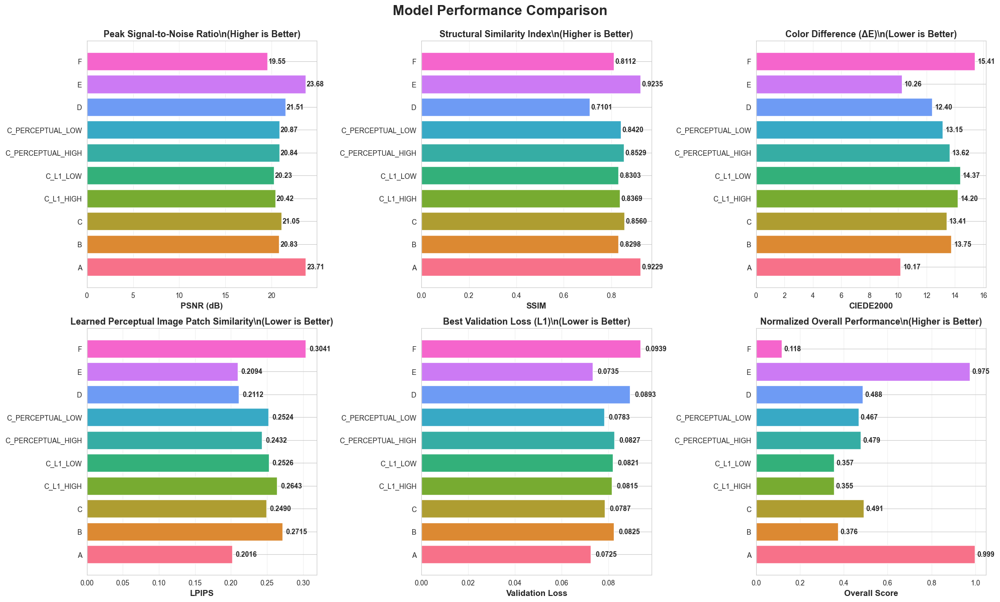

In [6]:
if metrics_df is not None:
    # Create comparison plots
    fig, axes = plt.subplots(2, 3, figsize=(20, 12))
    fig.suptitle('Model Performance Comparison', fontsize=20, fontweight='bold', y=0.995)
    
    # Sort by Model_ID for consistent ordering
    metrics_sorted = metrics_df.sort_values('Model_ID')
    colors = sns.color_palette("husl", len(metrics_sorted))
    
    # PSNR (higher is better)
    axes[0, 0].barh(metrics_sorted['Model_ID'], metrics_sorted['PSNR'], color=colors)
    axes[0, 0].set_xlabel('PSNR (dB)', fontsize=12, fontweight='bold')
    axes[0, 0].set_title('Peak Signal-to-Noise Ratio\\n(Higher is Better)', fontsize=13, fontweight='bold')
    axes[0, 0].grid(axis='x', alpha=0.3)
    for i, v in enumerate(metrics_sorted['PSNR']):
        axes[0, 0].text(v + 0.1, i, f'{v:.2f}', va='center', fontweight='bold')
    
    # SSIM (higher is better)
    axes[0, 1].barh(metrics_sorted['Model_ID'], metrics_sorted['SSIM'], color=colors)
    axes[0, 1].set_xlabel('SSIM', fontsize=12, fontweight='bold')
    axes[0, 1].set_title('Structural Similarity Index\\n(Higher is Better)', fontsize=13, fontweight='bold')
    axes[0, 1].grid(axis='x', alpha=0.3)
    for i, v in enumerate(metrics_sorted['SSIM']):
        axes[0, 1].text(v + 0.005, i, f'{v:.4f}', va='center', fontweight='bold')
    
    # CIEDE2000 (lower is better)
    axes[0, 2].barh(metrics_sorted['Model_ID'], metrics_sorted['CIEDE2000'], color=colors)
    axes[0, 2].set_xlabel('CIEDE2000', fontsize=12, fontweight='bold')
    axes[0, 2].set_title('Color Difference (ΔE)\\n(Lower is Better)', fontsize=13, fontweight='bold')
    axes[0, 2].grid(axis='x', alpha=0.3)
    for i, v in enumerate(metrics_sorted['CIEDE2000']):
        axes[0, 2].text(v + 0.2, i, f'{v:.2f}', va='center', fontweight='bold')
    
    # LPIPS (lower is better)
    axes[1, 0].barh(metrics_sorted['Model_ID'], metrics_sorted['LPIPS'], color=colors)
    axes[1, 0].set_xlabel('LPIPS', fontsize=12, fontweight='bold')
    axes[1, 0].set_title('Learned Perceptual Image Patch Similarity\\n(Lower is Better)', fontsize=13, fontweight='bold')
    axes[1, 0].grid(axis='x', alpha=0.3)
    for i, v in enumerate(metrics_sorted['LPIPS']):
        axes[1, 0].text(v + 0.005, i, f'{v:.4f}', va='center', fontweight='bold')
    
    # Best Validation Loss (lower is better)
    axes[1, 1].barh(metrics_sorted['Model_ID'], metrics_sorted['Best_Val_Loss'], color=colors)
    axes[1, 1].set_xlabel('Validation Loss', fontsize=12, fontweight='bold')
    axes[1, 1].set_title('Best Validation Loss (L1)\\n(Lower is Better)', fontsize=13, fontweight='bold')
    axes[1, 1].grid(axis='x', alpha=0.3)
    for i, v in enumerate(metrics_sorted['Best_Val_Loss']):
        axes[1, 1].text(v + 0.002, i, f'{v:.4f}', va='center', fontweight='bold')
    
    # Overall Score
    norm_psnr = (metrics_sorted['PSNR'] - metrics_sorted['PSNR'].min()) / (metrics_sorted['PSNR'].max() - metrics_sorted['PSNR'].min())
    norm_ssim = (metrics_sorted['SSIM'] - metrics_sorted['SSIM'].min()) / (metrics_sorted['SSIM'].max() - metrics_sorted['SSIM'].min())
    norm_ciede = 1 - (metrics_sorted['CIEDE2000'] - metrics_sorted['CIEDE2000'].min()) / (metrics_sorted['CIEDE2000'].max() - metrics_sorted['CIEDE2000'].min())
    norm_lpips = 1 - (metrics_sorted['LPIPS'] - metrics_sorted['LPIPS'].min()) / (metrics_sorted['LPIPS'].max() - metrics_sorted['LPIPS'].min())
    overall_score = (norm_psnr + norm_ssim + norm_ciede + norm_lpips) / 4
    
    axes[1, 2].barh(metrics_sorted['Model_ID'], overall_score, color=colors)
    axes[1, 2].set_xlabel('Overall Score', fontsize=12, fontweight='bold')
    axes[1, 2].set_title('Normalized Overall Performance\\n(Higher is Better)', fontsize=13, fontweight='bold')
    axes[1, 2].grid(axis='x', alpha=0.3)
    for i, v in enumerate(overall_score):
        axes[1, 2].text(v + 0.01, i, f'{v:.3f}', va='center', fontweight='bold')
    
    plt.tight_layout()
    plt.savefig('../results/Evaluate/comprehensive_metrics_comparison.png', dpi=150, bbox_inches='tight')
    print("\\n✓ Metrics comparison plot saved")
    plt.show()
else:
    print("✗ Cannot create comparison plots without metrics")


## 7. Training History Comparison

This section compares the **training and validation loss histories** of all models to evaluate:

- Convergence speed  
- Training stability  
- Possible overfitting or underfitting

For each `model_id` in `ALL_MODELS`, the notebook:

1. Loads the corresponding training history from:
   ```text
   ../results/<model_id>/training_history_<model_id>.csv
   ```

2. Extracts at least:

   * `epoch`
   * `train_loss` or `gen_loss`
   * `val_loss`

### Plots Produced

Two main plots are generated:

1. **Training loss vs. epoch**

   * Each model is shown as a separate curve on the same axes.
   * This reveals how quickly and how smoothly each model reduces its training loss.

2. **Validation loss vs. epoch**

   * Again, each model is plotted as a separate curve.
   * This reveals which models achieve lower validation plateaus and whether any models exhibit rising validation loss (a sign of overfitting).

Each model is assigned a distinct color and labeled in the legend.

### Interpretation

These plots support a **summary evaluation of optimization behavior**, making it easier to see:

* Which models converge fastest
* Which models stabilize at the lowest validation losses
* Whether adversarial or perceptual components tend to make training more or less stable

They complement the final scalar metrics by explaining **how** each model reached its final performance.

✓ Training history comparison saved


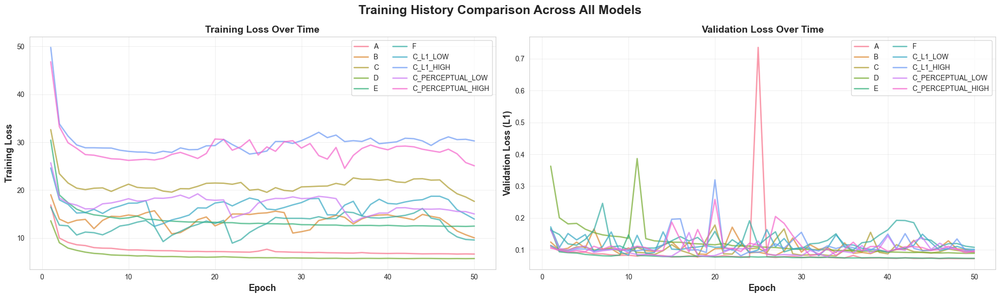

In [7]:
# Load training histories
fig, axes = plt.subplots(1, 2, figsize=(20, 6))
fig.suptitle('Training History Comparison Across All Models', fontsize=18, fontweight='bold')

colors = sns.color_palette("husl", len(ALL_MODELS))

for idx, model_id in enumerate(ALL_MODELS):
    history_path = Path(f"../results/{model_id}/training_history_{model_id}.csv")
    if history_path.exists():
        history = pd.read_csv(history_path)
        # Plot training loss
        axes[0].plot(history['epoch'], history['train_loss'], 
                    label=f"{model_id}", linewidth=2, color=colors[idx], alpha=0.7)
        # Plot validation loss
        axes[1].plot(history['epoch'], history['val_loss'], 
                    label=f"{model_id}", linewidth=2, color=colors[idx], alpha=0.7)

axes[0].set_xlabel('Epoch', fontsize=13, fontweight='bold')
axes[0].set_ylabel('Training Loss', fontsize=13, fontweight='bold')
axes[0].set_title('Training Loss Over Time', fontsize=14, fontweight='bold')
axes[0].legend(loc='best', fontsize=10, ncol=2)
axes[0].grid(True, alpha=0.3)

axes[1].set_xlabel('Epoch', fontsize=13, fontweight='bold')
axes[1].set_ylabel('Validation Loss (L1)', fontsize=13, fontweight='bold')
axes[1].set_title('Validation Loss Over Time', fontsize=14, fontweight='bold')
axes[1].legend(loc='best', fontsize=10, ncol=2)
axes[1].grid(True, alpha=0.3)

plt.tight_layout()
plt.savefig('../results/Evaluate/training_history_comparison.png', dpi=150, bbox_inches='tight')
print("✓ Training history comparison saved")
plt.show()


## 8. Load All Models for Inference

In this section, all trained generators are **reloaded from disk** and registered for evaluation.

### Model Loading Procedure

For each `model_id` in `ALL_MODELS`, the notebook:

1. Calls `load_model(model_id, device)`:
   - Instantiates a fresh U-Net generator.
   - Loads the checkpoint:
     ```text
     ../models/<model_id>/best_model.pt
     ```
   - Moves the model to the selected `device`.
   - Sets the model to evaluation mode with `eval()`.

2. If loading is successful, the generator is stored in the dictionary:
   ```python
   loaded_models[model_id] = generator
   ```

Models that are missing checkpoints or fail to load are skipped, and a message is printed.

### Summary of Loaded Models

After processing all entries in `ALL_MODELS`, the notebook prints:

* The number of models successfully loaded:

  ```python
  len(loaded_models)
  ```
* The list of model IDs that are available for inference.

This step acts as a **sanity check** before running any shared evaluation or visualization. Only the models present in `loaded_models` will participate in:

* Side-by-side inference on common test images
* Aggregated metric computation
* Visual comparison grids and final summary reports

In [8]:
# Load all models
loaded_models = {}

print("Loading all trained models...")
for model_id in tqdm(ALL_MODELS, desc="Loading models"):
    model = load_model(model_id, device)
    if model is not None:
        loaded_models[model_id] = model

print(f"\n✓ Successfully loaded {len(loaded_models)}/{len(ALL_MODELS)} models")
print(f"✓ Loaded models: {', '.join(loaded_models.keys())}")


Loading all trained models...


Loading models: 100%|██████████| 10/10 [00:03<00:00,  2.77it/s]


✓ Successfully loaded 10/10 models
✓ Loaded models: A, B, C, D, E, F, C_L1_LOW, C_L1_HIGH, C_PERCEPTUAL_LOW, C_PERCEPTUAL_HIGH


## 9. Evaluation Metrics Setup

This section defines the **evaluation metric class** used to compute PSNR, SSIM, CIEDE2000, and LPIPS in a **consistent** way for all models.

### ColorimetricEvaluator Class

The `ColorimetricEvaluator` encapsulates:

- A pretrained **LPIPS** model  
  ```python
  lpips_model = lpips.LPIPS(net="alex").to(device)
  lpips_model.eval()
  ```

* Helper methods to compute the following metrics for each batch of predictions and targets.

#### 1. PSNR (Peak Signal-to-Noise Ratio)

Given ground-truth RGB image $ x $ and predicted image $ \hat{x} $ in the range $[0, 1]$:

* Mean squared error:
  $$\mathrm{MSE}(x, \hat{x}) = \frac{1}{N} \sum_{i=1}^{N} (x_i - \hat{x}_i)^2$$
* PSNR (in dB):
  $$\mathrm{PSNR}(x, \hat{x}) = 10 \log_{10} \left( \frac{1^2}{\mathrm{MSE}(x, \hat{x})} \right)$$

In code, PSNR is computed using `peak_signal_noise_ratio` on each RGB pair and then averaged over the batch.

#### 2. SSIM (Structural Similarity Index)

SSIM captures similarity in luminance, contrast, and structure between two images $ x $ and $ y $:

$$
\mathrm{SSIM}(x, y) =
\frac{(2 \mu_x \mu_y + C_1)(2 \sigma_{xy} + C_2)}
{(\mu_x^2 + \mu_y^2 + C_1)(\sigma_x^2 + \sigma_y^2 + C_2)}
$$

where $ \mu_x, \mu_y $ are local means, $ \sigma_x^2, \sigma_y^2 $ are variances, and $ \sigma_{xy} $ is covariance.

In the implementation:

* Lab predictions and targets are converted to RGB.
* SSIM is computed with `structural_similarity` using `data_range=1.0` and `channel_axis=2`.
* The result is averaged over the batch.

#### 3. CIEDE2000 Color Difference

CIEDE2000 measures perceptual color differences in the Lab space.

Steps:

1. Convert normalized Lab values back to physical ranges:

   * $ L_{norm} \rightarrow L^* \in [0, 100] $
   * $ a_{norm}, b_{norm} \rightarrow a^*, b^* \in [-128, 128] $
2. For each image, sample pixels at a fixed stride (for computational efficiency).
3. Wrap each pixel as a `LabColor` for prediction and target, then compute:
   $$\Delta E_{00} = \mathrm{CIEDE2000}(Lab_{true}, Lab_{pred})$$
4. Average the per-pixel differences to obtain a mean CIEDE2000 value per image, and then average over the batch.

#### 4. LPIPS (Learned Perceptual Image Patch Similarity)

LPIPS measures perceptual dissimilarity using deep network features:

* RGB images are converted to tensors and rescaled to the range expected by the LPIPS model (typically $[-1, 1]$).
* The LPIPS network outputs a distance map, which is averaged over spatial locations and over the batch.

Lower LPIPS values indicate that generated images are more perceptually similar to the ground truth.

### Role in Evaluation Summary

By centralizing these computations in `ColorimetricEvaluator`, the notebook ensures that:

* All models are evaluated with **identical metric definitions**.
* Metric implementations are easy to reuse and extend.
* The evaluation criteria are **explicit and transparent** for inclusion in reports and summaries.


In [9]:
# Patch numpy for colormath compatibility
if not hasattr(np, "asscalar"):
    np.asscalar = lambda x: x.item() if hasattr(x, "item") else float(x)


class ColorimetricEvaluator:
    def __init__(self, device):
        self.device = device
        self.lpips_model = lpips.LPIPS(net="alex").to(device)
        self.lpips_model.eval()

    def calculate_psnr(self, L, ab_generated, ab_target):
        rgb_gen = lab_to_rgb_numpy(L, ab_generated)
        rgb_target = lab_to_rgb_numpy(L, ab_target)
        psnr_values = []
        for i in range(rgb_gen.shape[0]):
            psnr = peak_signal_noise_ratio(rgb_target[i], rgb_gen[i], data_range=1.0)
            psnr_values.append(psnr)
        return np.mean(psnr_values)

    def calculate_ssim(self, L, ab_generated, ab_target):
        rgb_gen = lab_to_rgb_numpy(L, ab_generated)
        rgb_target = lab_to_rgb_numpy(L, ab_target)
        ssim_values = []
        for i in range(rgb_gen.shape[0]):
            ssim = structural_similarity(rgb_target[i], rgb_gen[i], data_range=1.0, channel_axis=2)
            ssim_values.append(ssim)
        return np.mean(ssim_values)

    def calculate_ciede2000(self, L, ab_generated, ab_target):
        L_np = (L.cpu().numpy() + 1.0) * 50.0
        ab_gen_np = ab_generated.cpu().numpy() * 128.0
        ab_target_np = ab_target.cpu().numpy() * 128.0
        delta_e_values = []
        for b in range(L_np.shape[0]):
            L_channel = L_np[b, 0]
            step = 8
            sample_indices = [(i, j) for i in range(0, L_channel.shape[0], step) 
                             for j in range(0, L_channel.shape[1], step)]
            pixel_deltas = []
            for i, j in sample_indices:
                lab_gen = LabColor(L_channel[i, j], ab_gen_np[b, 0, i, j], ab_gen_np[b, 1, i, j])
                lab_target = LabColor(L_channel[i, j], ab_target_np[b, 0, i, j], ab_target_np[b, 1, i, j])
                delta_e = delta_e_cie2000(lab_gen, lab_target)
                pixel_deltas.append(delta_e)
            delta_e_values.append(np.mean(pixel_deltas))
        return np.mean(delta_e_values)

    def calculate_lpips(self, L, ab_generated, ab_target):
        with torch.no_grad():
            rgb_gen_np = lab_to_rgb_numpy(L, ab_generated)
            rgb_target_np = lab_to_rgb_numpy(L, ab_target)
            rgb_gen_tensor = (torch.from_numpy(rgb_gen_np).permute(0, 3, 1, 2).float() * 2 - 1).to(self.device)
            rgb_target_tensor = (torch.from_numpy(rgb_target_np).permute(0, 3, 1, 2).float() * 2 - 1).to(self.device)
            lpips_value = self.lpips_model(rgb_gen_tensor, rgb_target_tensor)
            return lpips_value.mean().item()

    def evaluate_batch(self, L, ab_generated, ab_target):
        metrics = {
            "PSNR": self.calculate_psnr(L, ab_generated, ab_target),
            "SSIM": self.calculate_ssim(L, ab_generated, ab_target),
            "CIEDE2000": self.calculate_ciede2000(L, ab_generated, ab_target),
            "LPIPS": self.calculate_lpips(L, ab_generated, ab_target),
        }
        return metrics


evaluator = ColorimetricEvaluator(device)
print("✓ Evaluator initialized")


c:\Users\USER\Documents\Dechathon_N\AIT\Computer Vision\Colorized-Image-Project\.venv\Lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\USER\Documents\Dechathon_N\AIT\Computer Vision\Colorized-Image-Project\.venv\Lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]
Loading model from: c:\Users\USER\Documents\Dechathon_N\AIT\Computer Vision\Colorized-Image-Project\.venv\Lib\site-packages\lpips\weights\v0.1\alex.pth
✓ Evaluator initialized


## 10. Inference on Same Test Images

To enable a **fair visual and quantitative comparison**, this section runs all models on the **same subset of test images**.

### Test Image Selection

- A fixed random seed (`SEED`) is used to select `NUM_INFERENCE_SAMPLES` indices from the test set.
- These indices are:
  - Printed for reference.
  - Reused for all models to ensure that each model is evaluated on exactly the same images.

### Inference Procedure

For each selected index:

1. The dataset returns:
   - Normalized luminance $L_{norm}$
   - Normalized ground-truth chrominance $ab_{norm}$
   - Grayscale tensor (for visualization)
   - Image path (for identification)

2. For each loaded model in `loaded_models`:
   - The generator predicts chrominance
     $$\hat{ab}_{norm} = G_\theta(L_{norm})$$
   - Using the evaluator, the following metrics are computed for that image–model pair:
     - PSNR
     - SSIM
     - CIEDE2000
     - LPIPS

3. All relevant data are stored in a structure such as `inference_results`, including:
   - Input tensors (luminance, chrominance, grayscale)
   - Model predictions
   - Per-image, per-model metric values

### Purpose of Shared Inference

By enforcing a **shared test subset** across models, this step makes it possible to:

- Perform **side-by-side visual comparison** on identical images.
- Compute **aggregated metrics** on a common subset, complementary to full-test metrics.
- Analyze specific examples where models differ significantly in colorization quality.

This shared inference subset forms the basis for the visual comparisons and aggregated inference summaries in the following sections.


In [10]:
# Select random test images for inference
np.random.seed(SEED)
test_indices = np.random.choice(len(test_dataset), NUM_INFERENCE_SAMPLES, replace=False)

print(f"Selected {NUM_INFERENCE_SAMPLES} test images for inference comparison")
print(f"Test indices: {test_indices}")

# Store results for each image
inference_results = {}

for idx in tqdm(test_indices, desc="Running inference"):
    L, ab_real, gray_img, img_path = test_dataset[idx]
    L_batch = L.unsqueeze(0).to(device)
    ab_real_batch = ab_real.unsqueeze(0).to(device)
    
    # Store results for this image
    img_results = {
        'L': L,
        'ab_real': ab_real,
        'gray': gray_img,
        'path': img_path,
        'predictions': {},
        'metrics': {}
    }
    
    # Run inference with all models
    with torch.no_grad():
        for model_id, model in loaded_models.items():
            ab_pred = model(L_batch)
            img_results['predictions'][model_id] = ab_pred.cpu().squeeze(0)
            
            # Calculate metrics
            metrics = evaluator.evaluate_batch(L_batch, ab_pred, ab_real_batch)
            img_results['metrics'][model_id] = metrics
    
    inference_results[idx] = img_results

print(f"\n✓ Inference completed for {NUM_INFERENCE_SAMPLES} images across {len(loaded_models)} models")


Selected 10 test images for inference comparison
Test indices: [ 81 158  66 599 334 640 155 101  77 357]


Running inference: 100%|██████████| 10/10 [00:11<00:00,  1.19s/it]


✓ Inference completed for 10 images across 10 models


## 11. Visualize Side-by-Side Comparison

This section produces **side-by-side visual comparisons** of all models on the same test images, enabling a clear **qualitative evaluation** of colorization performance.

### Figure Layout

For each selected test image (up to a fixed number, for example 6 images):

1. A multi-row, multi-column figure is created.
2. The first row (or first two panels) shows:
   - **Input (grayscale)** image.
   - **Ground-truth color** image reconstructed from the Lab channels.
3. Subsequent panels show the **generated colorizations** produced by each model in `loaded_models`.

Each panel is:

- Labeled with the corresponding model identifier, for example `A`, `B`, `C`, etc.
- Displayed without axis ticks or frames, so the visual content is emphasized.

### Purpose of the Visualization

This side-by-side comparison makes it easy to:

- Inspect **color choices** for the same grayscale input across different models.
- Judge **saturation, contrast, and realism** of the colorizations.
- Detect common **artifacts and failure cases**, such as:
  - Desaturation or overly gray outputs.
  - Color bleeding across object boundaries.
  - Incorrect or inconsistent hues.

While quantitative metrics (PSNR, SSIM, CIEDE2000, LPIPS) provide objective measures, this section focuses on the **subjective visual quality** of the results, which is crucial for a task like image colorization.


✓ Saved comparison for test image #81


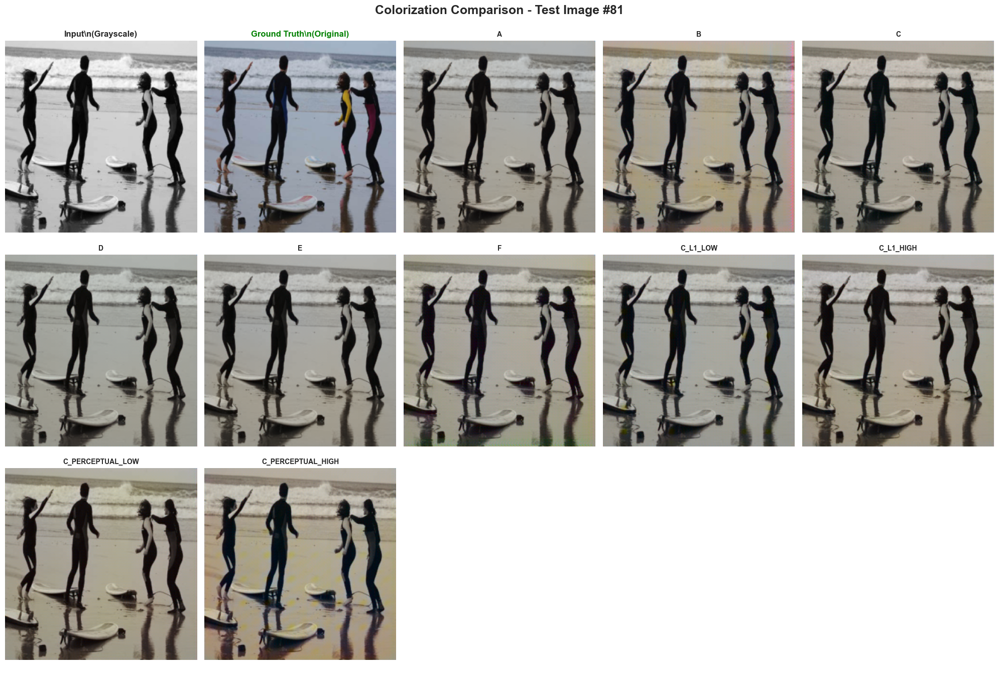

✓ Saved comparison for test image #158


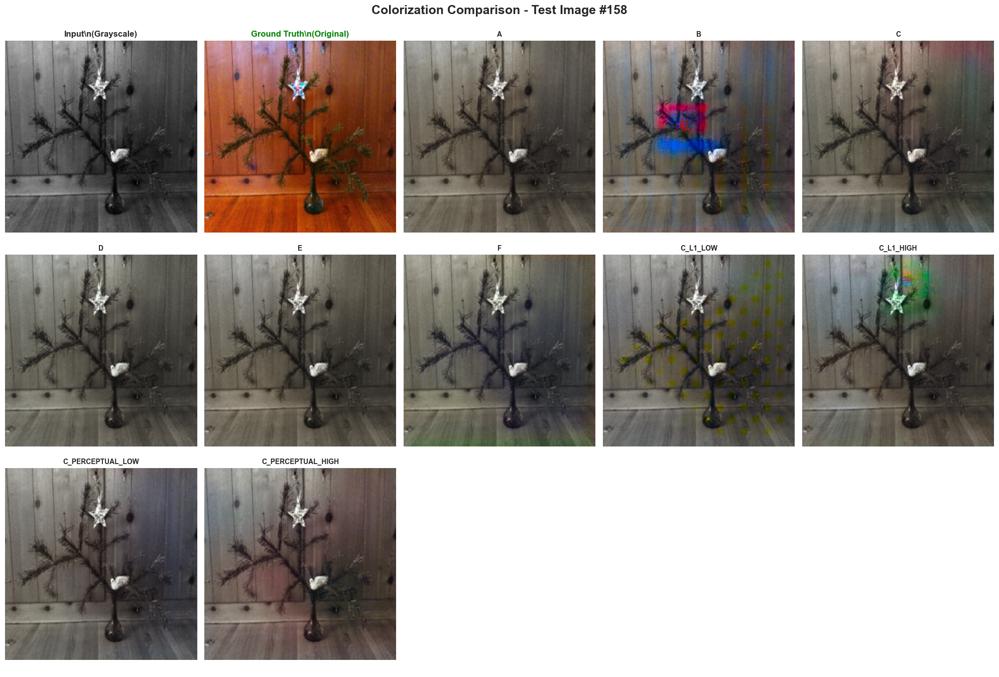

✓ Saved comparison for test image #66


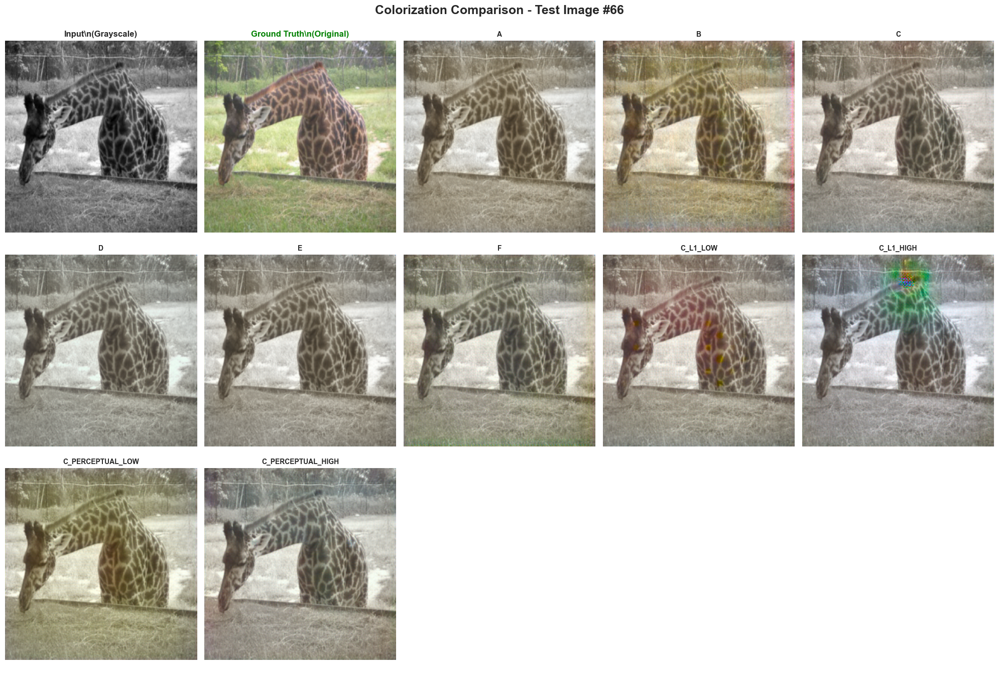

✓ Saved comparison for test image #599


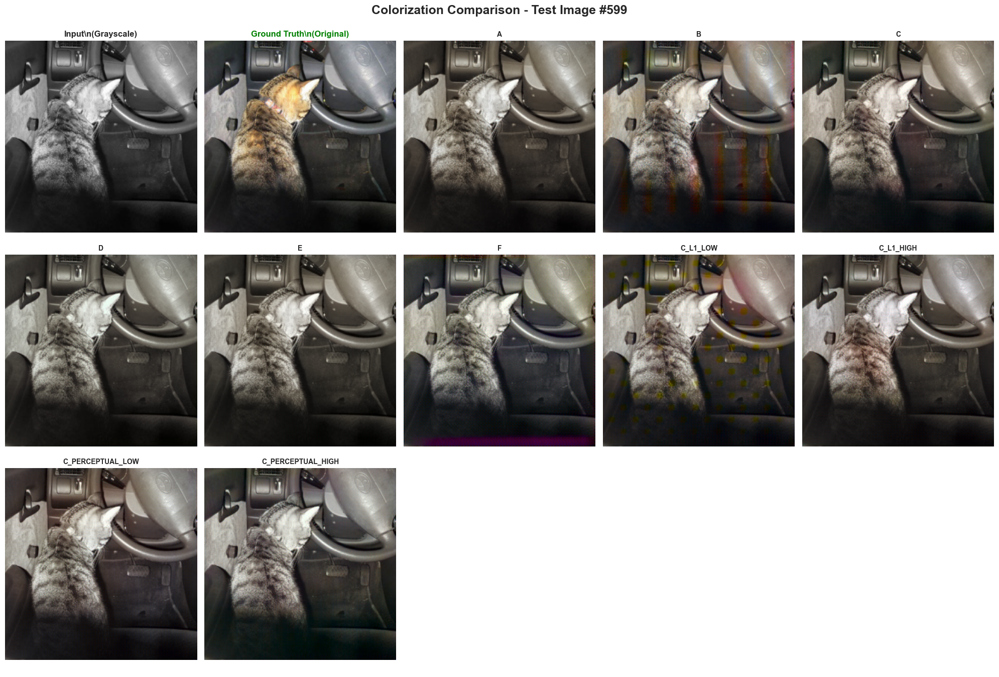

✓ Saved comparison for test image #334


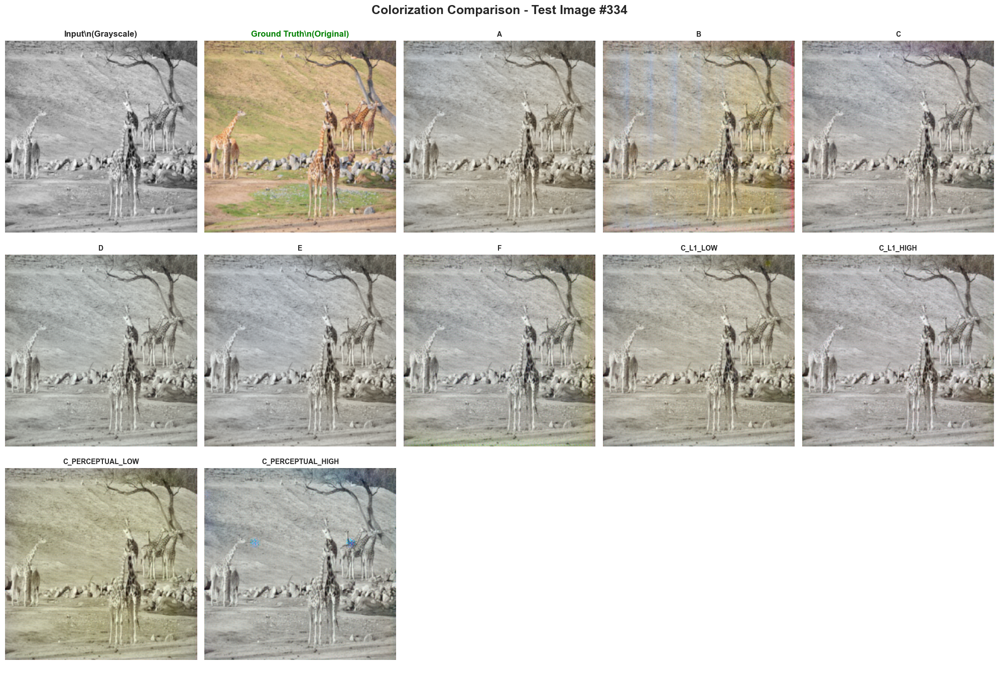

In [11]:
# Create comprehensive visualizations for each test image
for img_idx in list(test_indices)[:5]:  # Show first 5 images in detail
    results = inference_results[img_idx]
    
    # Calculate grid size
    num_models = len(loaded_models)
    total_images = num_models + 2  # +2 for input grayscale and ground truth
    cols = 5
    rows = (total_images + cols - 1) // cols
    
    fig, axes = plt.subplots(rows, cols, figsize=(cols * 4, rows * 4.5))
    axes = axes.flatten()
    
    fig.suptitle(f'Colorization Comparison - Test Image #{img_idx}', 
                 fontsize=18, fontweight='bold', y=0.995)
    
    # Display input grayscale
    axes[0].imshow(results['gray'].squeeze(), cmap='gray')
    axes[0].set_title('Input\\n(Grayscale)', fontsize=12, fontweight='bold')
    axes[0].axis('off')
    
    # Display ground truth
    L_np = (results['L'].squeeze().numpy() + 1.0) * 50.0
    ab_real_np = results['ab_real'].permute(1, 2, 0).numpy() * 128.0
    lab_real = np.zeros((IMG_SIZE, IMG_SIZE, 3))
    lab_real[:, :, 0] = L_np
    lab_real[:, :, 1:] = ab_real_np
    rgb_real = lab2rgb(lab_real)
    
    axes[1].imshow(rgb_real)
    axes[1].set_title('Ground Truth\\n(Original)', fontsize=12, fontweight='bold', color='green')
    axes[1].axis('off')
    
    # Display predictions from all models
    for idx, (model_id, ab_pred) in enumerate(results['predictions'].items()):
        ax_idx = idx + 2
        
        # Convert to RGB
        ab_pred_np = ab_pred.permute(1, 2, 0).numpy() * 128.0
        lab_pred = np.zeros((IMG_SIZE, IMG_SIZE, 3))
        lab_pred[:, :, 0] = L_np
        lab_pred[:, :, 1:] = ab_pred_np
        rgb_pred = lab2rgb(lab_pred)
        
        axes[ax_idx].imshow(rgb_pred)
        
        # Get metrics for this model
        metrics = results['metrics'][model_id]
        title = f"{model_id}"
        axes[ax_idx].set_title(title, fontsize=10, fontweight='bold')
        axes[ax_idx].axis('off')
    
    # Hide unused subplots
    for idx in range(total_images, len(axes)):
        axes[idx].axis('off')
    
    plt.tight_layout()
    plt.savefig(f'../results/Evaluate/comparison_test_image_{img_idx}.png', dpi=150, bbox_inches='tight')
    print(f"✓ Saved comparison for test image #{img_idx}")
    plt.show()


## 12. Aggregate Metrics from Inference

While per-image metrics provide detailed information, it is useful to **summarize performance across all sampled inference images**.

This section aggregates the metrics computed during shared inference on the selected subset of test images.

### Aggregation Procedure

1. Initialize a container to collect metrics for each model:
   ```python
   aggregated_metrics = {
       model_id: {"PSNR": [], "SSIM": [], "CIEDE2000": [], "LPIPS": []}
       for model_id in loaded_models.keys()
   }
   ```

2. Iterate over all entries in `inference_results`:

   * For each image:

     * For each `model_id`:

       * Append the per-image metric values (PSNR, SSIM, CIEDE2000, LPIPS) to the corresponding lists in `aggregated_metrics[model_id]`.

3. Compute **average metrics per model**:

   ```python
   avg_metrics = []
   for model_id, metrics in aggregated_metrics.items():
       avg_metrics.append({
           "Model_ID":       model_id,
           "Avg_PSNR":      np.mean(metrics["PSNR"]),
           "Avg_SSIM":      np.mean(metrics["SSIM"]),
           "Avg_CIEDE2000": np.mean(metrics["CIEDE2000"]),
           "Avg_LPIPS":     np.mean(metrics["LPIPS"]),
       })
   ```

   The result is converted into a summary DataFrame such as `avg_metrics_df`.

### Interpretation and Role in Evaluation

The resulting table typically includes:

* `Model_ID`
* `Avg_PSNR`
* `Avg_SSIM`
* `Avg_CIEDE2000`
* `Avg_LPIPS`

This provides a **concise evaluation summary** of how each model performs on the **common inference subset**, complementing:

* The full-test metrics loaded from CSV (Section 5),
* The side-by-side visual comparison (Section 11).

In reports, this table can be cited as evidence of **relative performance on a fixed, visually inspected subset** of the test set.

In [12]:
# Aggregate metrics across all inference images
aggregated_metrics = {model_id: {'PSNR': [], 'SSIM': [], 'CIEDE2000': [], 'LPIPS': []} 
                     for model_id in loaded_models.keys()}

for img_idx, results in inference_results.items():
    for model_id, metrics in results['metrics'].items():
        for metric_name, value in metrics.items():
            aggregated_metrics[model_id][metric_name].append(value)

# Calculate averages
avg_metrics = []
for model_id in loaded_models.keys():
    avg_metrics.append({
        'Model_ID': model_id,
        'Avg_PSNR': np.mean(aggregated_metrics[model_id]['PSNR']),
        'Avg_SSIM': np.mean(aggregated_metrics[model_id]['SSIM']),
        'Avg_CIEDE2000': np.mean(aggregated_metrics[model_id]['CIEDE2000']),
        'Avg_LPIPS': np.mean(aggregated_metrics[model_id]['LPIPS']),
        'Std_PSNR': np.std(aggregated_metrics[model_id]['PSNR']),
        'Std_SSIM': np.std(aggregated_metrics[model_id]['SSIM']),
        'Std_CIEDE2000': np.std(aggregated_metrics[model_id]['CIEDE2000']),
        'Std_LPIPS': np.std(aggregated_metrics[model_id]['LPIPS']),
    })

inference_metrics_df = pd.DataFrame(avg_metrics)

print("\n" + "="*120)
print(f"INFERENCE METRICS ON {NUM_INFERENCE_SAMPLES} TEST IMAGES")
print("="*120)
print(inference_metrics_df.to_string(index=False))
print("="*120)

# Save to CSV
inference_metrics_df.to_csv('../results/Evaluate/inference_metrics_comparison.csv', index=False)
print("\n✓ Inference metrics saved to: ../results/Evaluate/inference_metrics_comparison.csv")



INFERENCE METRICS ON 10 TEST IMAGES
         Model_ID  Avg_PSNR  Avg_SSIM  Avg_CIEDE2000  Avg_LPIPS  Std_PSNR  Std_SSIM  Std_CIEDE2000  Std_LPIPS
                A 22.656381  0.899596      11.948668   0.236076  5.645910  0.103317       5.133608   0.133897
                B 21.272690  0.813080      13.489219   0.272056  4.611304  0.091415       4.616216   0.108429
                C 21.979923  0.858144      13.171315   0.237224  5.175897  0.094864       4.724632   0.127869
                D 20.456997  0.676019      13.110442   0.249775  4.513692  0.088184       3.479985   0.144306
                E 22.481590  0.898125      12.221679   0.247292  5.672380  0.104431       5.424320   0.139192
                F 20.861047  0.749398      14.337628   0.267347  4.605738  0.079535       4.767593   0.137670
         C_L1_LOW 22.116728  0.831205      12.404587   0.262679  4.668097  0.091992       4.254027   0.117635
        C_L1_HIGH 21.494802  0.848542      13.604824   0.244203  5.346277  0.108088

## 13. Create Complete Comparison Grid

This section constructs a **large, consolidated image grid** that summarizes **all models across multiple test images**.

### Grid Structure

The grid is organized as follows:

- **Rows** correspond to different test images (up to a fixed number, for example 5 images).
- **Columns** correspond to:
  1. Input grayscale image (`Input`)
  2. Ground-truth color image (`Truth`)
  3. One column for each model in `loaded_models` (for example `A`, `B`, `C`, `D`, `E`, `F`, and C-variants)

For each cell in the grid:

- The corresponding RGB image is rendered:
  - Column 1: grayscale input image.
  - Column 2: ground-truth color image.
  - Remaining columns: model-specific colorization outputs.
- Column headers clearly indicate the model or reference type (Input, Truth, Model A, Model B, etc.).
- Axes are hidden to keep the focus on visual comparison.

### Purpose of the Comparison Grid

This grid serves as a **global qualitative summary**, making it easy to:

- Inspect how each model behaves across **several different inputs**.
- Identify models that are consistently strong or weak across **diverse scenes**.
- Observe patterns such as:
  - Overly desaturated colorizations.
  - Unrealistic hues or color shifts.
  - Differences in sharpness and detail preservation.

Because all models and images are shown in a single figure, this grid is particularly valuable for:

- **Presentations** (slides or posters).
- **Reports and theses**, where a single figure can provide an at-a-glance comparison of all approaches.


✓ Complete comparison grid saved to: ../results/Evaluate/complete_comparison_grid.png


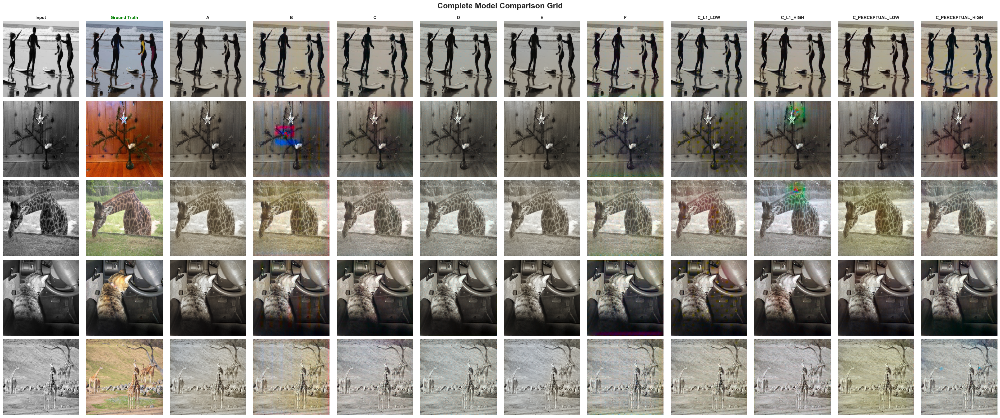

In [13]:
# Create a large comparison grid showing all models on all inference images
num_images = min(len(test_indices), 5)  # Show up to 5 images in grid
display_indices = list(test_indices)[:num_images]
num_models = len(loaded_models) + 2  # +2 for input and ground truth

fig, axes = plt.subplots(num_images, num_models, figsize=(num_models * 3, num_images * 3))
if num_images == 1:
    axes = axes.reshape(1, -1)
fig.suptitle('Complete Model Comparison Grid', fontsize=20, fontweight='bold', y=0.995)

# Column headers
col_names = ['Input', 'Truth'] + list(loaded_models.keys())

for row_idx, img_idx in enumerate(display_indices):
    results = inference_results[img_idx]
    
    # Prepare LAB components
    L_np = (results['L'].squeeze().numpy() + 1.0) * 50.0
    ab_real_np = results['ab_real'].permute(1, 2, 0).numpy() * 128.0
    
    # Input grayscale
    axes[row_idx, 0].imshow(results['gray'].squeeze(), cmap='gray')
    if row_idx == 0:
        axes[row_idx, 0].set_title('Input', fontsize=11, fontweight='bold')
    axes[row_idx, 0].set_ylabel(f'Test #{img_idx}', fontsize=10, fontweight='bold')
    axes[row_idx, 0].axis('off')
    
    # Ground truth
    lab_real = np.zeros((IMG_SIZE, IMG_SIZE, 3))
    lab_real[:, :, 0] = L_np
    lab_real[:, :, 1:] = ab_real_np
    rgb_real = lab2rgb(lab_real)
    axes[row_idx, 1].imshow(rgb_real)
    if row_idx == 0:
        axes[row_idx, 1].set_title('Ground Truth', fontsize=11, fontweight='bold', color='green')
    axes[row_idx, 1].axis('off')
    
    # All model predictions
    for col_idx, (model_id, ab_pred) in enumerate(results['predictions'].items()):
        ab_pred_np = ab_pred.permute(1, 2, 0).numpy() * 128.0
        lab_pred = np.zeros((IMG_SIZE, IMG_SIZE, 3))
        lab_pred[:, :, 0] = L_np
        lab_pred[:, :, 1:] = ab_pred_np
        rgb_pred = lab2rgb(lab_pred)
        
        axes[row_idx, col_idx + 2].imshow(rgb_pred)
        if row_idx == 0:
            axes[row_idx, col_idx + 2].set_title(model_id, fontsize=11, fontweight='bold')
        axes[row_idx, col_idx + 2].axis('off')

plt.tight_layout()
plt.savefig('../results/Evaluate/complete_comparison_grid.png', dpi=200, bbox_inches='tight')
print("✓ Complete comparison grid saved to: ../results/Evaluate/complete_comparison_grid.png")
plt.show()


## 14. Best Model Analysis

This section performs a **summary analysis** to identify the **best-performing models** according to different evaluation criteria.

Using `metrics_df` (the combined full-test metrics table), the notebook evaluates:

1. **Best PSNR**
   - Finds the model with the highest PSNR value.
   - Interpreted as the model with the best average reconstruction fidelity.

2. **Best SSIM**
   - Finds the model with the highest SSIM value.
   - Interpreted as the model that best preserves structural information and contrast.

3. **Best CIEDE2000**
   - Finds the model with the lowest CIEDE2000 value.
   - Interpreted as the model with the smallest perceptual color difference to the ground truth.

4. **Best LPIPS**
   - Finds the model with the lowest LPIPS value.
   - Interpreted as the model whose outputs are most perceptually similar to the ground truth according to a learned deep feature metric.

For each criterion, the notebook prints:

- The winning `Model_ID`
- The corresponding `Description`
- The metric value that justifies this ranking

### Interpretation

This criterion-wise analysis provides a clear **evaluation summary** that answers questions such as:

- Which model is best if we care primarily about pixel-level reconstruction (PSNR)?
- Which model is best if we care about structural quality (SSIM)?
- Which model is best if we prioritize color accuracy (CIEDE2000)?
- Which model is best in terms of perceptual similarity (LPIPS)?

Because different applications may prioritize different metrics, this section helps justify **which model should be chosen** under each evaluation objective.


In [14]:
# Determine best model based on different criteria
if metrics_df is not None:
    print("\n" + "="*80)
    print("BEST MODEL BY DIFFERENT CRITERIA")
    print("="*80)
    
    best_psnr = metrics_df.loc[metrics_df['PSNR'].idxmax()]
    print(f"\nBest PSNR: {best_psnr['Model_ID']} - {best_psnr['PSNR']:.4f} dB")
    print(f"   Description: {best_psnr['Description']}")
    
    best_ssim = metrics_df.loc[metrics_df['SSIM'].idxmax()]
    print(f"\nBest SSIM: {best_ssim['Model_ID']} - {best_ssim['SSIM']:.4f}")
    print(f"   Description: {best_ssim['Description']}")
    
    best_ciede = metrics_df.loc[metrics_df['CIEDE2000'].idxmin()]
    print(f"\nBest CIEDE2000: {best_ciede['Model_ID']} - {best_ciede['CIEDE2000']:.4f}")
    print(f"   Description: {best_ciede['Description']}")
    
    best_lpips = metrics_df.loc[metrics_df['LPIPS'].idxmin()]
    print(f"\nBest LPIPS: {best_lpips['Model_ID']} - {best_lpips['LPIPS']:.4f}")
    print(f"   Description: {best_lpips['Description']}")
    
    best_val = metrics_df.loc[metrics_df['Best_Val_Loss'].idxmin()]
    print(f"\nBest Validation Loss: {best_val['Model_ID']} - {best_val['Best_Val_Loss']:.4f}")
    print(f"   Description: {best_val['Description']}")
    
    print("\n" + "=" * 80)
    
    # Overall ranking
    norm_psnr = (metrics_df['PSNR'] - metrics_df['PSNR'].min()) / (metrics_df['PSNR'].max() - metrics_df['PSNR'].min())
    norm_ssim = (metrics_df['SSIM'] - metrics_df['SSIM'].min()) / (metrics_df['SSIM'].max() - metrics_df['SSIM'].min())
    norm_ciede = 1 - (metrics_df['CIEDE2000'] - metrics_df['CIEDE2000'].min()) / (metrics_df['CIEDE2000'].max() - metrics_df['CIEDE2000'].min())
    norm_lpips = 1 - (metrics_df['LPIPS'] - metrics_df['LPIPS'].min()) / (metrics_df['LPIPS'].max() - metrics_df['LPIPS'].min())
    
    metrics_df['Overall_Score'] = (norm_psnr + norm_ssim + norm_ciede + norm_lpips) / 4
    
    ranked_df = metrics_df.sort_values('Overall_Score', ascending=False)
    
    print("\nOVERALL RANKING (Based on Normalized Scores):")
    print("=" * 80)
    for idx, row in enumerate(ranked_df.itertuples(), 1):
        print(f"{idx}. {row.Model_ID} - Score: {row.Overall_Score:.4f} - {row.Description}")
    print("=" * 80)



BEST MODEL BY DIFFERENT CRITERIA

Best PSNR: A - 23.7139 dB
   Description: U-Net + L1 (pure regression)

Best SSIM: E - 0.9235
   Description: U-Net + L1 + Perceptual (no GAN)

Best CIEDE2000: A - 10.1660
   Description: U-Net + L1 (pure regression)

Best LPIPS: A - 0.2016
   Description: U-Net + L1 (pure regression)

Best Validation Loss: A - 0.0725
   Description: U-Net + L1 (pure regression)


OVERALL RANKING (Based on Normalized Scores):
1. A - Score: 0.9992 - U-Net + L1 (pure regression)
2. E - Score: 0.9749 - U-Net + L1 + Perceptual (no GAN)
3. C - Score: 0.4909 - cGAN + L1 + Perceptual (main proposed model)
4. D - Score: 0.4876 - U-Net + Perceptual (no L1, no GAN)
5. C_PERCEPTUAL_HIGH - Score: 0.4787 - cGAN + L1 + Perceptual (main proposed model with high Perceptual weight)
6. C_PERCEPTUAL_LOW - Score: 0.4675 - cGAN + L1 + Perceptual (main proposed model with low Perceptual weight)
7. B - Score: 0.3756 - cGAN + L1 (pix2pix-style)
8. C_L1_LOW - Score: 0.3572 - cGAN + L1 + Perce

## 15. Summary Report

This final section generates a **comprehensive textual summary** of the evaluation, suitable for inclusion in a project report or thesis.

### 1. Dataset and Evaluation Setup Summary

- Test set:
  - Total number of test images used for full-metric evaluation.
  - Number of images used for shared, side-by-side inference and qualitative comparison.
- Preprocessing:
  - All images evaluated at a fixed resolution `IMG_SIZE x IMG_SIZE`.
  - No data augmentation applied during evaluation.
- Hardware and environment:
  - Device used for inference (CPU, GPU, or MPS).
  - Common evaluation pipeline applied to all models.

### 2. Models and Configurations Evaluated

- Total number of models evaluated:
  - Core variants (A–F).
  - Ablation variants around Model C (different $L_1$ and perceptual weights).
- For each model family, note the main design differences:
  - Use of GAN loss vs. no GAN.
  - Use of perceptual loss vs. purely pixel-based loss.
  - Different $L_1$ and perceptual loss weights.

This provides context for understanding why models behave differently in the metrics.

### 3. Quantitative Evaluation Summary

Using the combined metrics tables (full-test metrics and aggregated inference metrics), this section summarizes:

- **Overall best model(s)** under each metric:
  - PSNR and SSIM (reconstruction and structural quality).
  - CIEDE2000 and LPIPS (perceptual and color fidelity).
- **Trade-offs between metrics**:
  - Cases where one model has slightly higher PSNR but worse LPIPS or CIEDE2000.
  - Models that offer a good compromise across several metrics.

If desired, the notebook can compute a simple **composite score** (for example, a normalized combination of metrics) to propose a single “overall best” model, but the individual metrics remain the primary basis for evaluation.

### 4. Qualitative Evaluation Summary

Based on the side-by-side visual comparisons and the complete comparison grid, this section summarizes:

- Typical strengths observed:
  - Which models produce more vivid and realistic colors.
  - Which models preserve edges and details better.
- Typical weaknesses or artifacts:
  - Desaturated or washed-out outputs.
  - Color bleeding, incorrect hues, or instability in GAN-based models.
- Consistency across different image types:
  - How models behave on complex scenes vs. simple objects.
  - Robustness to variations in texture and lighting.

This qualitative analysis complements the numerical results and reflects **human visual judgment**, which is crucial for colorization tasks.

### 5. Recommended Model and Justification

Finally, the notebook states a **recommended model configuration** for practical use, for example:

- Model ID and description (e.g. “Model C: cGAN + L1 + Perceptual”).
- Key metric values (PSNR, SSIM, CIEDE2000, LPIPS) on the test set.
- A short justification, such as:
  - Strong overall balance across all metrics.
  - Good visual quality with limited artifacts.
  - Stable training and robust behavior across diverse images.

The conclusion explains clearly **why this model is preferred** and under what priorities (pixel accuracy, perceptual realism, or a balance of both).

---

Together, these points form a **coherent evaluation summary**, tying the numerical metrics, training histories, and visual comparisons into a clear narrative that can be directly reused in the written p


In [15]:
# Generate comprehensive summary report
print("\n" + "=" * 100)
print("COMPREHENSIVE MODEL EVALUATION SUMMARY")
print("=" * 100)

print("\nDataset Information:")
print(f"  - Test Set Size: {len(test_dataset)} images")
print(f"  - Inference Sample Size: {NUM_INFERENCE_SAMPLES} images")
print(f"  - Image Resolution: {IMG_SIZE}×{IMG_SIZE} pixels")

print(f"\nModels Evaluated: {len(loaded_models)}/{len(ALL_MODELS)}")
print(f"  - Successfully Loaded: {', '.join(loaded_models.keys())}")

print("\nEvaluation Metrics:")
print("  ✓ PSNR (Peak Signal-to-Noise Ratio) - Higher is better")
print("  ✓ SSIM (Structural Similarity Index) - Higher is better")
print("  ✓ CIEDE2000 (Color Difference) - Lower is better")
print("  ✓ LPIPS (Learned Perceptual Image Patch Similarity) - Lower is better")

if metrics_df is not None:
    print("\nKey Findings:")
    print(f"      Overall Best Model: {ranked_df.iloc[0]['Model_ID']}")
    print(f"     - Description: {ranked_df.iloc[0]['Description']}")
    print(f"     - Overall Score: {ranked_df.iloc[0]['Overall_Score']:.4f}")
    print(f"     - PSNR: {ranked_df.iloc[0]['PSNR']:.2f} dB")
    print(f"     - SSIM: {ranked_df.iloc[0]['SSIM']:.4f}")
    print(f"     - CIEDE2000: {ranked_df.iloc[0]['CIEDE2000']:.2f}")
    print(f"     - LPIPS: {ranked_df.iloc[0]['LPIPS']:.4f}")
    
    print(f"\n     Second Best: {ranked_df.iloc[1]['Model_ID']} (Score: {ranked_df.iloc[1]['Overall_Score']:.4f})")
    print(f"     Third Best: {ranked_df.iloc[2]['Model_ID']} (Score: {ranked_df.iloc[2]['Overall_Score']:.4f})")

print("\nGenerated Outputs:")
print("  ✓ Metrics comparison plot: ../results/Evaluate/comprehensive_metrics_comparison.png")
print("  ✓ Training history comparison: ../results/Evaluate/training_history_comparison.png")
print("  ✓ Individual image comparisons: ../results/Evaluate/comparison_test_image_*.png")
print("  ✓ Complete comparison grid: ../results/Evaluate/complete_comparison_grid.png")
print("  ✓ Inference metrics CSV: ../results/Evaluate/inference_metrics_comparison.csv")

print("\n" + "=" * 100)
print("EVALUATION COMPLETED SUCCESSFULLY")
print("=" * 100)



COMPREHENSIVE MODEL EVALUATION SUMMARY

Dataset Information:
  - Test Set Size: 739 images
  - Inference Sample Size: 10 images
  - Image Resolution: 256×256 pixels

Models Evaluated: 10/10
  - Successfully Loaded: A, B, C, D, E, F, C_L1_LOW, C_L1_HIGH, C_PERCEPTUAL_LOW, C_PERCEPTUAL_HIGH

Evaluation Metrics:
  ✓ PSNR (Peak Signal-to-Noise Ratio) - Higher is better
  ✓ SSIM (Structural Similarity Index) - Higher is better
  ✓ CIEDE2000 (Color Difference) - Lower is better
  ✓ LPIPS (Learned Perceptual Image Patch Similarity) - Lower is better

Key Findings:
      Overall Best Model: A
     - Description: U-Net + L1 (pure regression)
     - Overall Score: 0.9992
     - PSNR: 23.71 dB
     - SSIM: 0.9229
     - CIEDE2000: 10.17
     - LPIPS: 0.2016

     Second Best: E (Score: 0.9749)
     Third Best: C (Score: 0.4909)

Generated Outputs:
  ✓ Metrics comparison plot: ../results/Evaluate/comprehensive_metrics_comparison.png
  ✓ Training history comparison: ../results/Evaluate/training_hi